# Crop Prediction Analysis

Description: Analysis of CropNop and Segmentation model predictions on images in the Firestore Database

Author: Ivan Zvonkov

Date: October 9, 2023


In [1]:
from google.cloud import firestore, storage
from io import BytesIO
from PIL import Image
from tqdm import tqdm

import pandas as pd
import matplotlib
import matplotlib.pyplot as plt

## Data Prep: Pull in data from Firebase
Can skip if csv already available

In [35]:
db = firestore.Client()
coll = db.collection("street2sat-v2")

In [36]:
result = coll.count().get()
entry_count = result[0][0].value
print(f"As of {result[0][0].read_time} number of entries: {entry_count}")

As of 2023-11-13 00:15:07.749777+00:00 number of entries: 2482194


In [37]:
# This version just runs through all entries of the database (takes 16 minutes for ~2 million entries)
total_runs = (entry_count // 1000) + 1

In [1]:
all_docs = []
docs = coll.order_by("input_img")
for i in tqdm(range(total_runs), desc="Queries"):
    for doc in docs.limit(1000).stream():
        all_docs.append(doc.to_dict())
    last_input_img = all_docs[-1]["input_img"]
    docs = coll.order_by("input_img").start_after({"input_img": last_input_img})

NameError: name 'coll' is not defined

In [39]:
df_all = pd.DataFrame(all_docs)

In [40]:
len(df_all)

2482194

In [41]:
df_all.to_csv("../data/street2sat-v2.csv", index=False)

## Data Prep: Read in as csv

In [ ]:
df_all = pd.read_csv("../data/street2sat-v2.csv")

/var/folders/1v/87y9n_d5143c_6cp072v3b1c0000gn/T/ipykernel_94223/2016021947.py:1: DtypeWarning: Columns (9,12,13,14,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv("../data/street2sat-v2.csv")


In [22]:
# Associate folders with each row
input_img_str_split = df_all["input_img"].str.split("/")
df_all["country_folder"] = input_img_str_split.str[3]
df_all["country_subfolder"] = input_img_str_split.str[4]

In [23]:
country_folders = list(df_all["country_folder"].unique())

## General Analysis: Crop or Not Proportions by Folder

In [24]:
greens = matplotlib.colormaps.get_cmap('Greens')

In [25]:
proportions = []
for country_folder in country_folders:
    preds_for_country_folder = df_all[(df_all["country_folder"] == country_folder)]
    crop_amount = (preds_for_country_folder["is_crop"] == True).sum()
    total = len(preds_for_country_folder)
    proportions.append({"Crops": crop_amount, "Total": total, "Proportion": round(crop_amount / total, 3)})

def _color(val):
    return f"background-color: {matplotlib.colors.rgb2hex(greens(val / 2))}"

pd.DataFrame(proportions, index=country_folders).style.map(_color, subset="Proportion").format(precision=3)

,Crops,Total,Proportion
KENYA_v2,143288,397190,0.361
MPONGWE_v2,1021,1809,0.564
NIGERIA_v2,502615,892710,0.563
TANZANIA_v2,11130,33280,0.334
USA_v2,54253,75006,0.723
Uganda_v2,252731,597872,0.423
ZAMBIA_v2,254999,481208,0.530
test_set,695,1350,0.515
test_set_divided_v2,200,419,0.477
test_set_divided_v3,695,1350,0.515


## General Analysis: Specific crop type proportions

In [26]:
df_crops = df_all[df_all["is_crop"] == True]

In [27]:
nan_segmentation = []
for country_folder in country_folders:
    preds_for_country_folder = df_crops[(df_crops["country_folder"] == country_folder)]
    not_segmented = (preds_for_country_folder["results"].isna()).sum()
    total = len(preds_for_country_folder)
    nan_segmentation.append({"Not Segmented": not_segmented, "Total": total, "Proportion": round(not_segmented / total, 3)})
    
pd.DataFrame(nan_segmentation, index=country_folders).style.map(_color, subset="Proportion").format(precision=3)

,Not Segmented,Total,Proportion
KENYA_v2,335,143288,0.002
MPONGWE_v2,0,1021,0.000
NIGERIA_v2,4393,502615,0.009
TANZANIA_v2,465,11130,0.042
USA_v2,100,54253,0.002
Uganda_v2,693,252731,0.003
ZAMBIA_v2,614,254999,0.002
test_set,1,695,0.001
test_set_divided_v2,0,200,0.000
test_set_divided_v3,0,695,0.000


In [28]:
df_crops = df_crops[~df_crops["results"].isna()].reset_index()

In [30]:
predictions = pd.json_normalize(df_crops["results"].apply(eval))

In [31]:
df_crops = pd.concat([df_crops, predictions], axis=1)

In [32]:
crops = list(predictions.columns[1:])

In [33]:
def generate_crop_type_distribution(pixel_proportion_threshold, normalize = True, background = False):
    segmented_as = "background" if background else "crop type"
    print(f"{pixel_proportion_threshold} proportion of pixels segmented as {segmented_as}, normalized={normalize}")
    crop_pixels = []
    for country_folder in country_folders:
        df_country = df_crops[df_crops["country_folder"] == country_folder]
        total = len(df_country)
        if background:
            result = {
                "background": (df_country["background"] > pixel_proportion_threshold).sum()/total,
                "total": total
            }
        elif normalize:
            result = {crop: (df_country[crop] > pixel_proportion_threshold).sum()/total for crop in crops}
        
        else:
            result = {crop: (df_country[crop] > pixel_proportion_threshold).sum() for crop in crops}
            result["total"] = total

        crop_pixels.append(result)
            
    df = pd.DataFrame(crop_pixels, index=country_folders)

    def _color(val):
        rgba = greens(val / df[crops if not background else "background"].max().max() / 2)
        color = matplotlib.colors.rgb2hex(rgba)
        return f"background-color: {color}"

    if background:
        return df.style.map(_color, subset="background").format(precision=2)
    else:
        return df.style.map(_color, subset=crops).format(precision=2)

### Are there sufficient predictions?

About a quarter of the images are segmented as 99.9% background.

In [34]:
generate_crop_type_distribution(pixel_proportion_threshold=0.999, background=True)

0.999 proportion of pixels segmented as background, normalized=True


,background,total
KENYA_v2,0.29,142953
MPONGWE_v2,0.05,1021
NIGERIA_v2,0.23,498222
TANZANIA_v2,0.23,10665
USA_v2,0.12,54153
Uganda_v2,0.28,252038
ZAMBIA_v2,0.11,254385
test_set,0.25,694
test_set_divided_v2,0.28,200
test_set_divided_v3,0.25,695


In [50]:
storage_client = storage.Client()
bucket = storage_client.get_bucket('street2sat-uploaded')

def plot_sample(sample, title):
    images = list(sample["input_img"])
    fig, axes = plt.subplots(2, 3, figsize=(20, 10))
    fig.tight_layout()
    fig.suptitle(title, y=0.0)
    k = 0
    for i in range(2):
        for j in range(3):
            blob = bucket.get_blob(images[k].replace("gs://street2sat-uploaded/", ""))
            img = Image.open(BytesIO(blob.download_as_bytes()))
            axes[i][j].imshow(img)
            k += 1

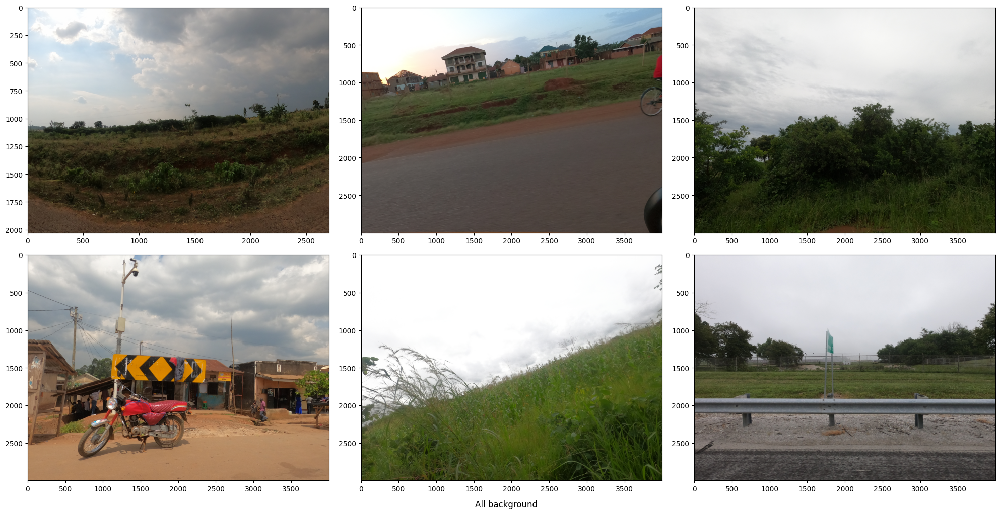

In [51]:
sample = df_crops[(df_crops["background"] > 0.999) & ~df_crops["segmentation_images"].isna()].sample(6)
plot_sample(sample, "All background")

In [52]:
sample

,index,pixel_height,focal_length,time,is_crop,coord,input_img,results,name,segmentation_images,...,country_subfolder,background,sunflower,wheat,soybean,banana,maize,sugarcane,rice,tobacco
49131,96510,2028.0,3.0,2021-07-20 15:44:12+00:00,True,"[-0.09382489999999999, 34.3215821]",gs://street2sat-uploaded/KENYA_v2/2021_07_20_T...,"{'background': 0.9999, 'sunflower': 0.0, 'whea...",KENYA_v2-2021_07_20_T2-106GOPRO-GPGR9318,['gs://street2sat-segmentations/KENYA_v2/2021_...,...,2021_07_20_T2,0.9999,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0001
435918,903216,3000.0,3.0,2021-06-21 18:42:46+00:00,True,"[0.4421193999722222, 33.2151566]",gs://street2sat-uploaded/Uganda_v2/1829244/202...,"{'background': 0.9999, 'sunflower': 0.0, 'whea...",Uganda_v2-1829244-2020-06-21_Edrick_21_24-2020...,['gs://street2sat-segmentations/Uganda_v2/1829...,...,1829244,0.9999,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0001
732175,1575231,3000.0,3.0,2023-02-17 14:48:16+00:00,True,"[-14.980204499972222, 27.8417399]",gs://street2sat-uploaded/ZAMBIA_v2/CHIBOMBO/G0...,"{'background': 0.9999, 'sunflower': 0.0, 'whea...",ZAMBIA_v2-CHIBOMBO-G0361300,['gs://street2sat-segmentations/ZAMBIA_v2/CHIB...,...,CHIBOMBO,0.9999,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0001
544508,1208860,3000.0,3.0,2021-06-28 12:59:47+00:00,True,"[0.5405453, 32.78731479997222]",gs://street2sat-uploaded/Uganda_v2/1829244/202...,"{'background': 0.9997, 'sunflower': 0.0, 'whea...",Uganda_v2-1829244-2020-06-28_Edrick-2020-06-28...,['gs://street2sat-segmentations/Uganda_v2/1829...,...,1829244,0.9997,0.0,0.0001,0.0,0.0,0.0,0.0000,0.0,0.0001
774134,1637958,3000.0,3.0,2023-02-16 12:07:34+00:00,True,"[-15.216990799972223, 28.65127599997222]",gs://street2sat-uploaded/ZAMBIA_v2/CHONGWE/G05...,"{'background': 0.9992, 'sunflower': 0.0, 'whea...",ZAMBIA_v2-CHONGWE-G0542962,['gs://street2sat-segmentations/ZAMBIA_v2/CHON...,...,CHONGWE,0.9992,0.0,0.0000,0.0,0.0,0.0,0.0006,0.0,0.0001
371339,809299,3000.0,3.0,2021-08-17 09:04:33+00:00,True,"[40.57942899997222, -85.82473109997221]",gs://street2sat-uploaded/USA_v2/2021-08-20-cro...,"{'background': 0.9999, 'sunflower': 0.0, 'whea...",USA_v2-2021-08-20-croptour-123GOPRO-G0155084,['gs://street2sat-segmentations/USA_v2/2021-08...,...,2021-08-20-croptour,0.9999,0.0,0.0000,0.0,0.0,0.0,0.0000,0.0,0.0001


### Do crops predicted generally match crops grown in country?

In [18]:
generate_crop_type_distribution(pixel_proportion_threshold=0.01, normalize=False)

0.01 proportion of pixels segmented as crop type, normalized=False


,sunflower,wheat,soybean,banana,maize,sugarcane,rice,tobacco,total
KENYA_v2,10581,4400,3519,6231,52555,13042,8337,102,142953
MPONGWE_v2,126,116,29,1,498,197,181,2,1021
NIGERIA_v2,77410,2188,5375,4020,21094,18780,6240,2681,199839
TANZANIA_v2,1732,676,677,107,1126,372,3736,6,10665
USA_v2,536,2392,26437,45,6958,12478,7466,146,54153
Uganda_v2,18974,7004,2257,92828,23603,20314,5895,419,252038
ZAMBIA_v2,51687,30904,7949,1639,92635,22486,72525,320,254385
test_set,34,34,113,57,136,87,69,1,694
test_set_divided_v2,14,14,13,34,28,22,16,0,200
test_set_divided_v3,34,34,113,57,137,87,70,1,695


In [19]:
generate_crop_type_distribution(pixel_proportion_threshold=0.01, normalize=True)

0.01 proportion of pixels segmented as crop type, normalized=True


,sunflower,wheat,soybean,banana,maize,sugarcane,rice,tobacco
KENYA_v2,0.07,0.03,0.02,0.04,0.37,0.09,0.06,0.00
MPONGWE_v2,0.12,0.11,0.03,0.00,0.49,0.19,0.18,0.00
NIGERIA_v2,0.39,0.01,0.03,0.02,0.11,0.09,0.03,0.01
TANZANIA_v2,0.16,0.06,0.06,0.01,0.11,0.03,0.35,0.00
USA_v2,0.01,0.04,0.49,0.00,0.13,0.23,0.14,0.00
Uganda_v2,0.08,0.03,0.01,0.37,0.09,0.08,0.02,0.00
ZAMBIA_v2,0.20,0.12,0.03,0.01,0.36,0.09,0.29,0.00
test_set,0.05,0.05,0.16,0.08,0.20,0.13,0.10,0.00
test_set_divided_v2,0.07,0.07,0.07,0.17,0.14,0.11,0.08,0.00
test_set_divided_v3,0.05,0.05,0.16,0.08,0.20,0.13,0.10,0.00


### Kenya

National statistics from USDA: https://ipad.fas.usda.gov/countrysummary/default.aspx?id=KE

<img src=attachment:f6e23c06-e7db-4e19-a338-f6c967b62e89.png width=400px />

**Predictions**:
1. Maize: most predicted similar to USDA production numbers ✅
2. Sugar cane: not mentioned in USDA production, however looks correctly predicted from small sample below.
3. Sunflower: not mentioned in USDA production, from small sample seems to be over predicted.
4. Rice: predicted a medium quantity, similar to USDA production numbers ✅
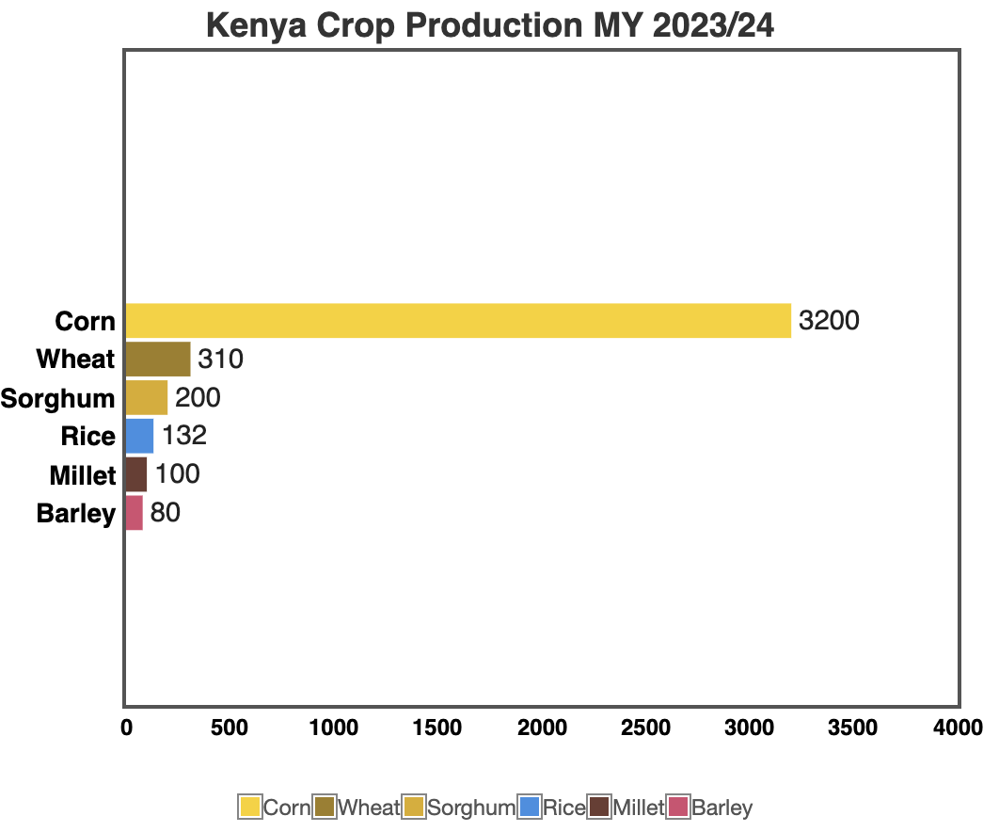

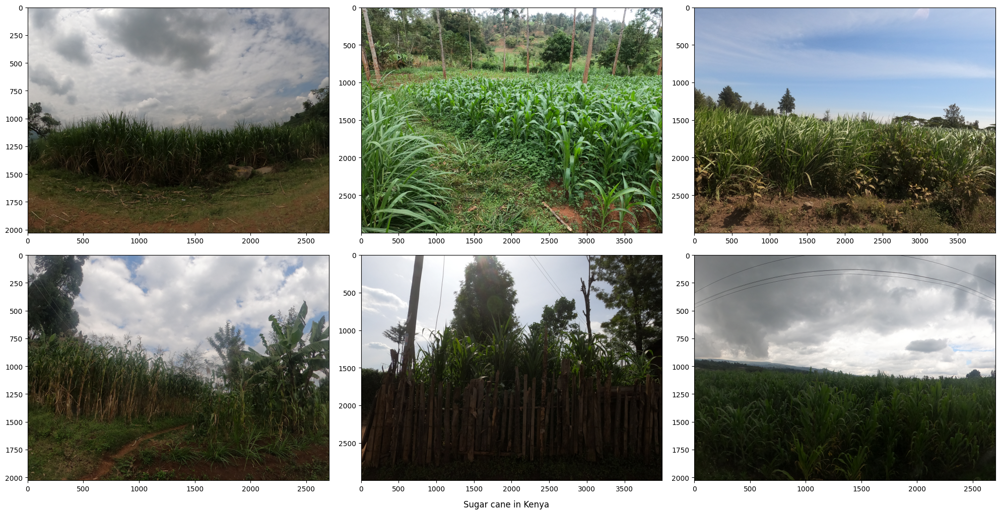

In [53]:
kenya_sugarcane_sample = df_crops[(df_crops["country_folder"] == "KENYA_v2") & (df_crops["sugarcane"] > 0.1)].sample(6)
plot_sample(kenya_sugarcane_sample, "Sugar cane in Kenya")

# Sugar cane looks correctly predicted

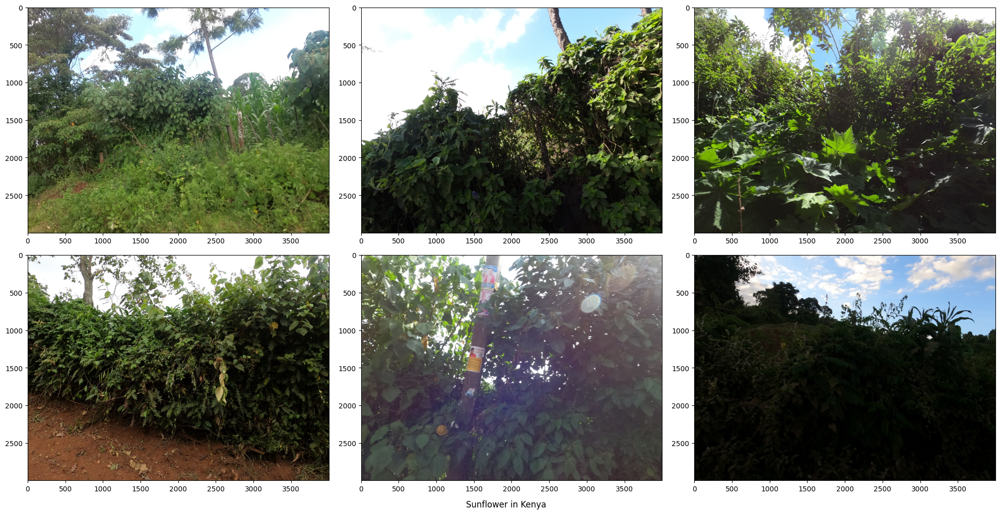

In [55]:
kenya_sunflower_sample = df_crops[(df_crops["country_folder"] == "KENYA_v2") & (df_crops["sunflower"] > 0.1)].sample(6)
plot_sample(kenya_sunflower_sample, "Sunflower in Kenya")

# Definitely not sunflower, seems like bushes at edge of fields

### Nigeria

National statistics from USDA: https://ipad.fas.usda.gov/countrysummary/Default.aspx?id=NI

<img src=attachment:ecb127bb-c4e3-4e90-86a1-b312dbd2ad53.png width=400px />

**Predictions**:
1. Sunflower - not included in USDA stats, over predicted based on small sample below.
2. Maize - should be majority, close to statistics.
3. Sugar cane - not included in USDA stats, sometimes over predicted based on small sample below.
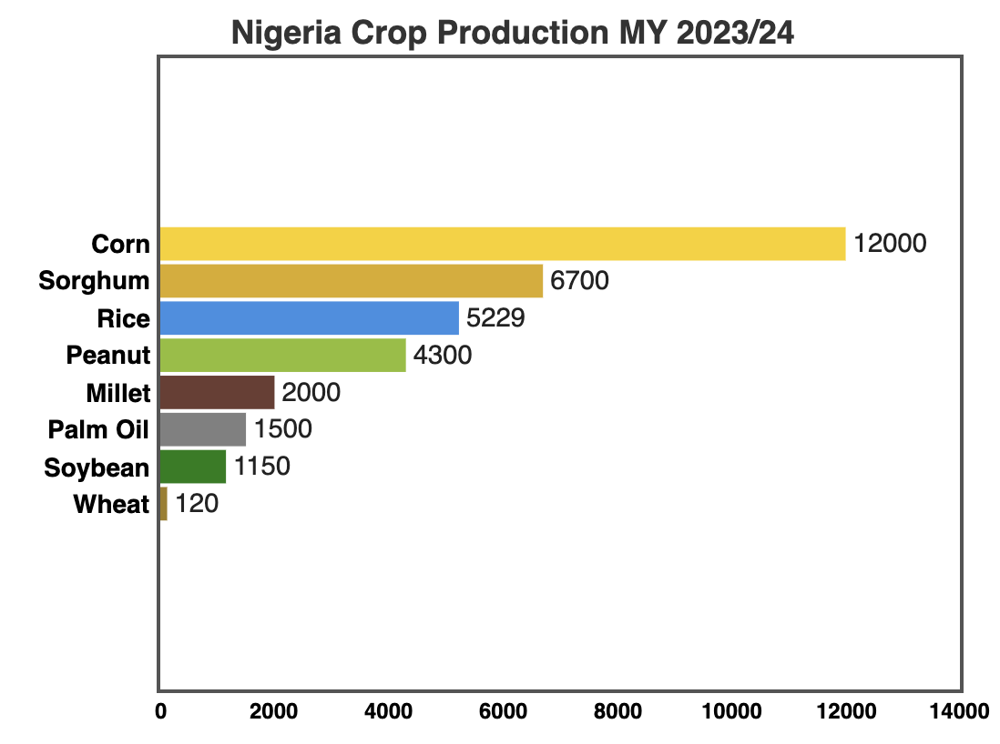

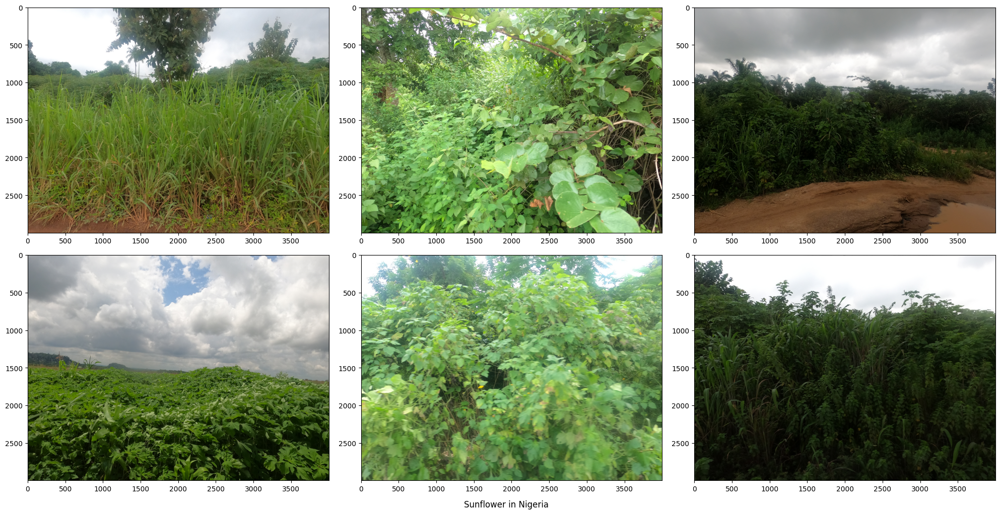

In [58]:
nigeria_sunflower_sample = df_crops[(df_crops["country_folder"] == "NIGERIA_v2") & (df_crops["sunflower"] > 0.1)].sample(6)
plot_sample(nigeria_sunflower_sample, "Sunflower in Nigeria")

# Sunflower incorrectly predicted in many different images

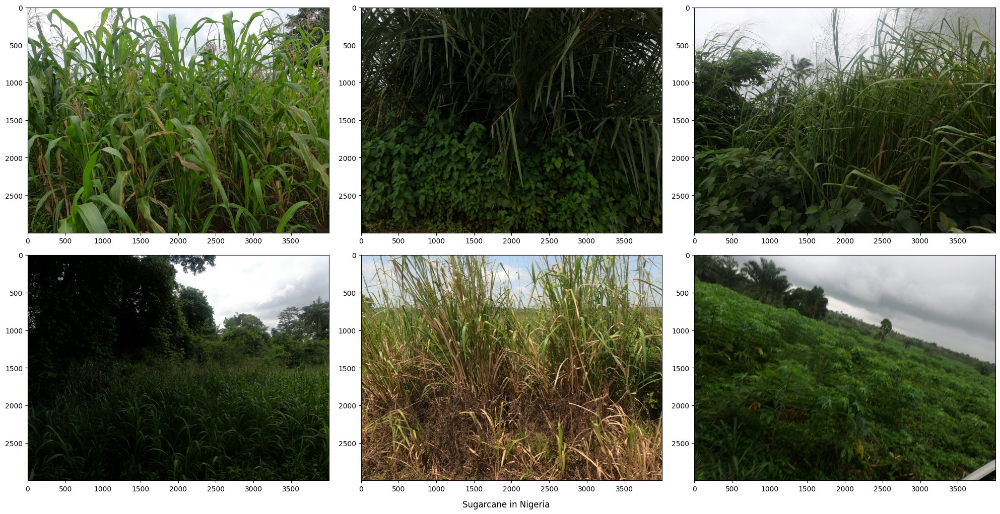

In [59]:
nigeria_sugarcane_sample = df_crops[(df_crops["country_folder"] == "NIGERIA_v2") & (df_crops["sugarcane"] > 0.1)].sample(6)
plot_sample(nigeria_sugarcane_sample, "Sugarcane in Nigeria")

# Sugarcane sometimes predicted correctly

### Tanzania

National statistics from USDA: https://ipad.fas.usda.gov/countrysummary/Default.aspx?id=TZ


<img src= attachment:1ea35462-b0cd-4c33-ac72-c1114ac7253e.png width=400px/>

**Predictions**:
1. Rice - likely over predicted based on sample below.
2. Sunflower - likely over predicted like in previous countries.
3. Maize - potentially under predicted.
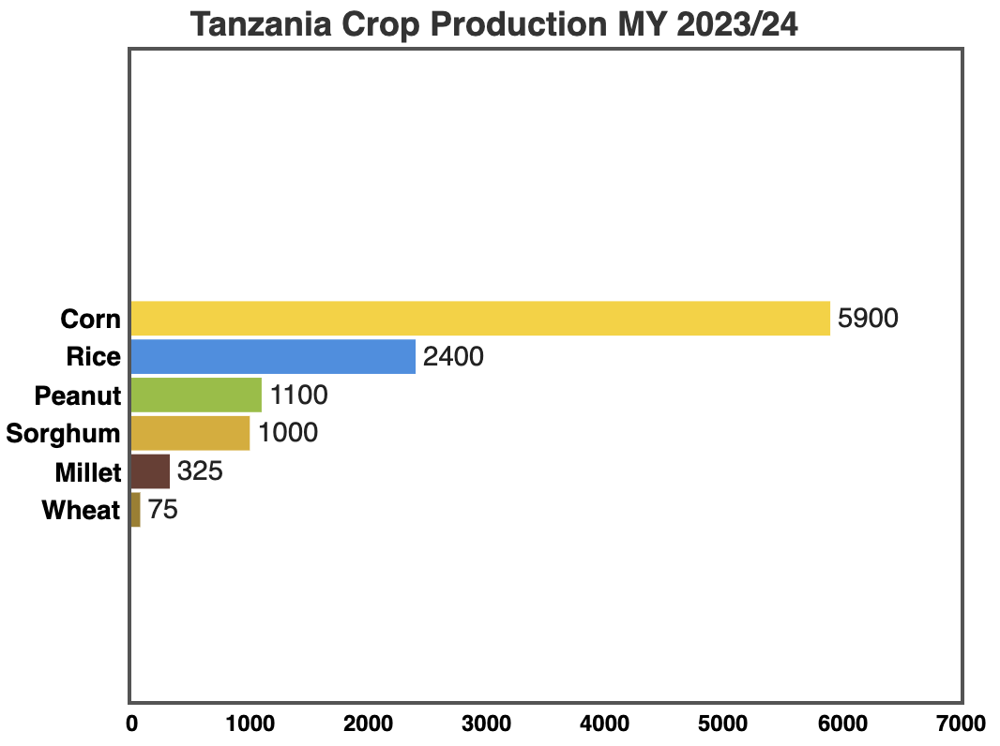

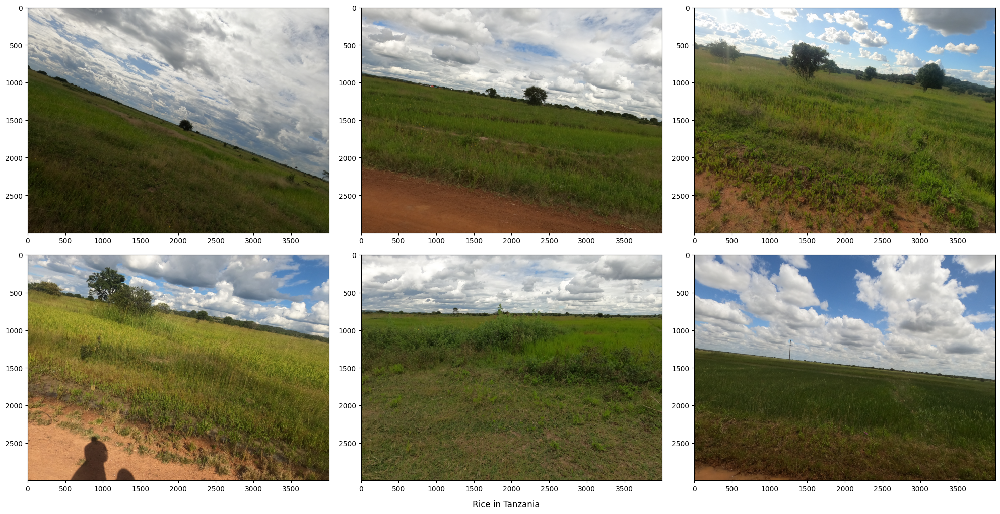

In [60]:
tanzania_rice_sample = df_crops[(df_crops["country_folder"] == "TANZANIA_v2") & (df_crops["rice"] > 0.1)].sample(6)
plot_sample(tanzania_rice_sample, "Rice in Tanzania")

# Could be rice but also potentially another crop just younger and shorter.

### Uganda

National crop statistics from USDA: https://ipad.fas.usda.gov/countrysummary/Default.aspx?id=UG

<img src=attachment:d3c67c1e-7b84-443f-9fff-b5e6db914e86.png width=400px />

**Predictions**:
1. Banana - Not included in USDA statistics. Predicted often, but seemingly correctly.
2. Maize - Majority of crops in USDA statistics, correctly predicted in small sample. Somewhat matches statistics.
3. Sugarcane - Not included in USDA statistics.
4. Sunflower - Not included in USDA statistics, likely over predicted
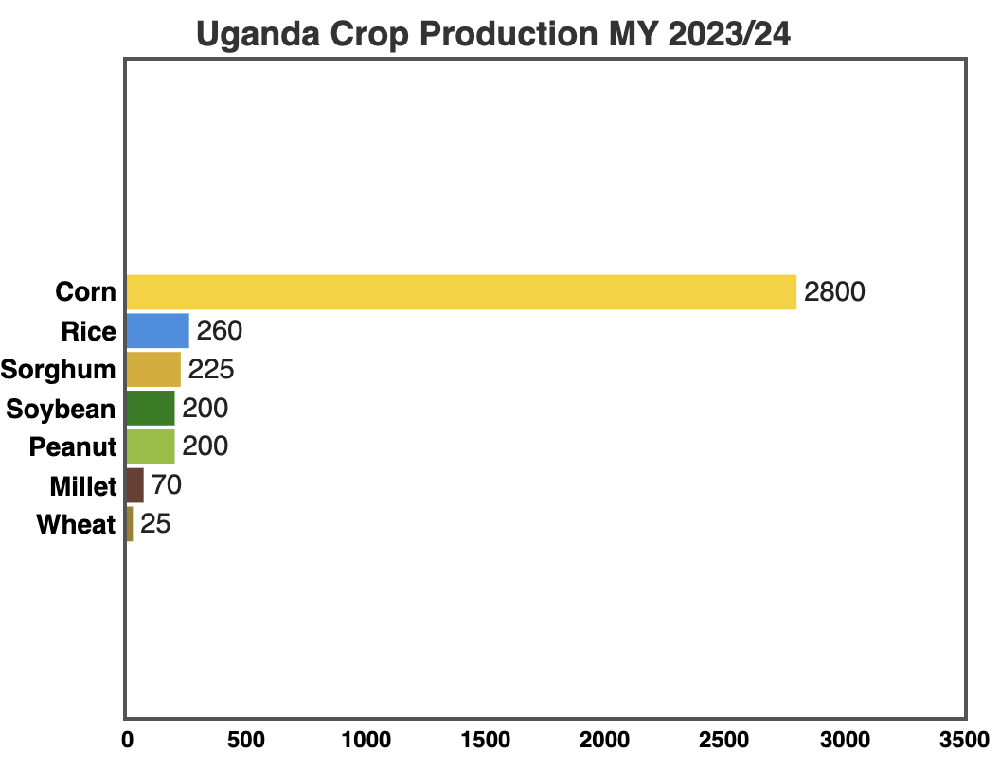

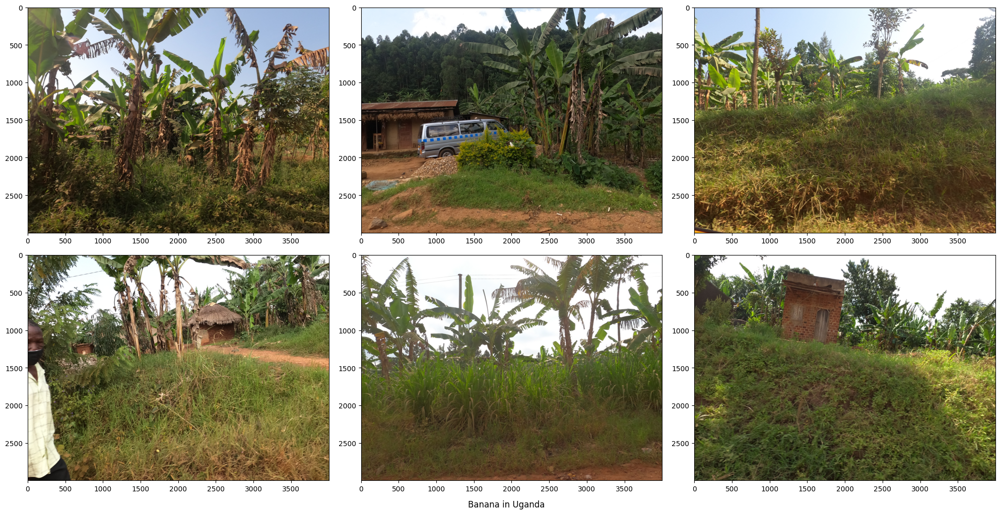

In [61]:
uganda_banana_sample = df_crops[(df_crops["country_folder"] == "Uganda_v2") & (df_crops["banana"] > 0.1)].sample(6)
plot_sample(uganda_banana_sample, "Banana in Uganda")

# Correctly predicted in small sample, likely just lot's of banana trees in photos.

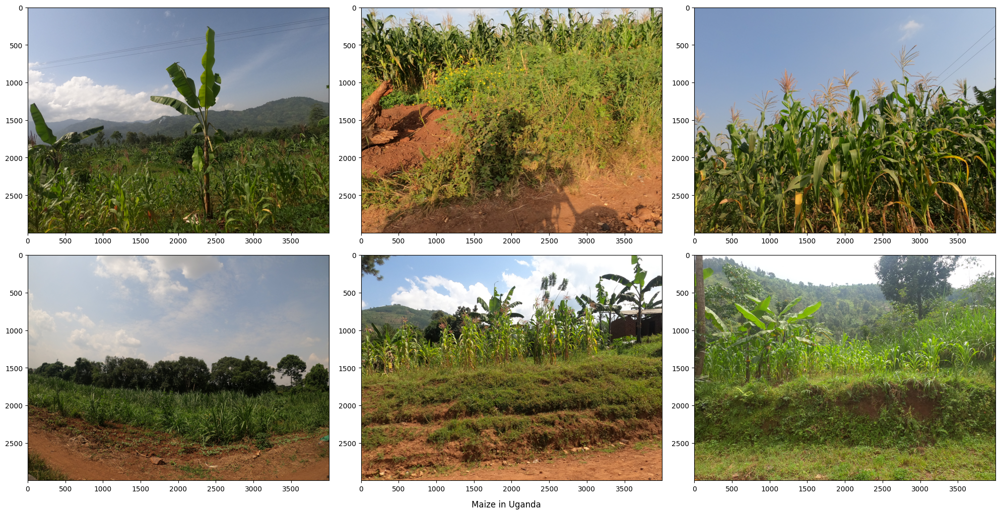

In [62]:
uganda_maize_sample = df_crops[(df_crops["country_folder"] == "Uganda_v2") & (df_crops["maize"] > 0.1)].sample(6)
plot_sample(uganda_maize_sample, "Maize in Uganda")

# Correctly predicted in small sample

### Zambia

Crop statistics from USDA: 

<img src=attachment:b897e4c1-ffe5-4b93-aa1a-2d808e82a8ec.png width=400px />

**Predictions**:
1. Maize - matches statistics.
2. Rice - may be over predicted.
3. Sunflower - likely over predicted like prior countries.
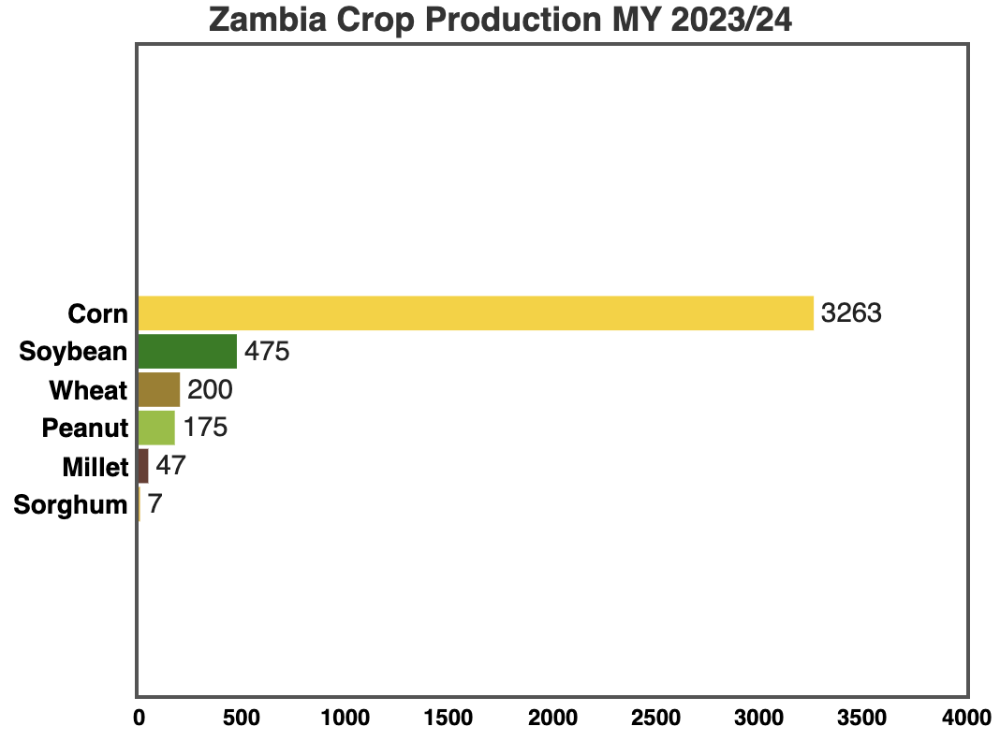

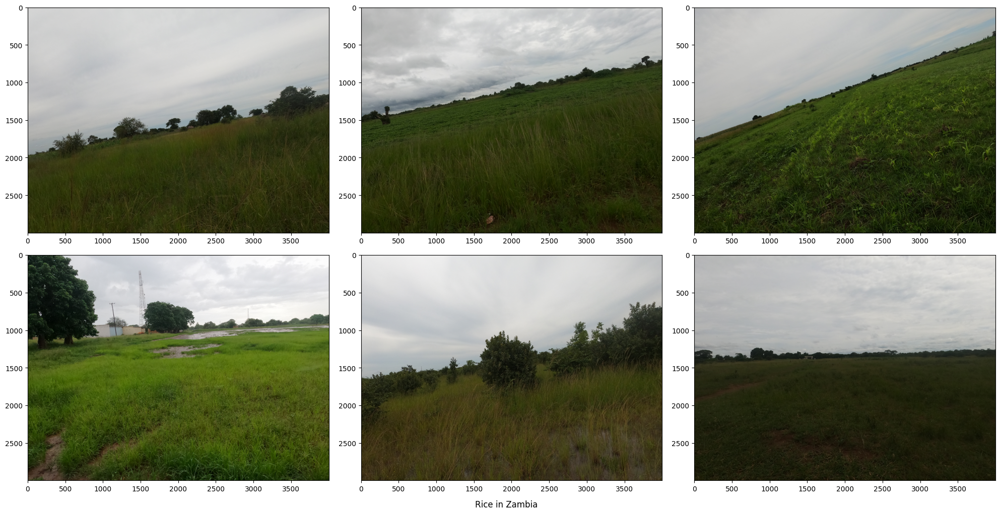

In [63]:
zambia_rice_sample = df_crops[(df_crops["country_folder"] == "ZAMBIA_v2") & (df_crops["rice"] > 0.1)].sample(6)
plot_sample(zambia_rice_sample, "Rice in Zambia")

# Could be rice but also potentially another crop just younger and shorter.

#### Mpongwe

Copperbelt Region in Zambia, statistics from: https://ipad.fas.usda.gov/countrysummary/default.aspx?id=ZA
1. Soybean 20-40k tons
2. Maize 15-30k tons
3. Peanut 2-7k tons

**Predictions**:
1. Maize
2. Sugarcane
3. Rice

Potentiall should be more soybean.


### USA

**Predictions**:
1. Soybean - Seems correct from sample. Does not show up much in other countries.
2. Sugarcane - confuses with maize.
3. Rice - incorrectly classified.

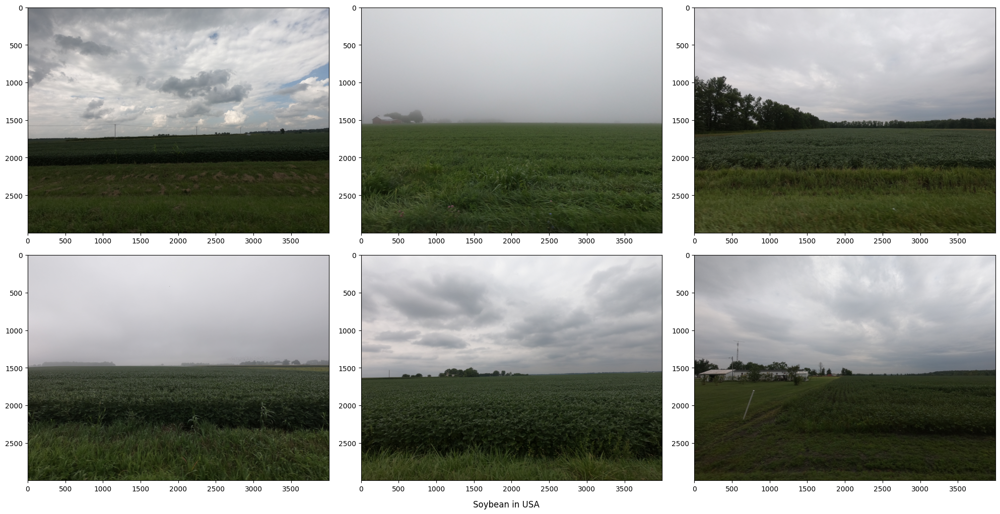

In [67]:
usa_soybean_sample = df_crops[(df_crops["country_folder"] == "USA_v2") & (df_crops["soybean"] > 0.1)].sample(6)
plot_sample(usa_soybean_sample, "Soybean in USA")

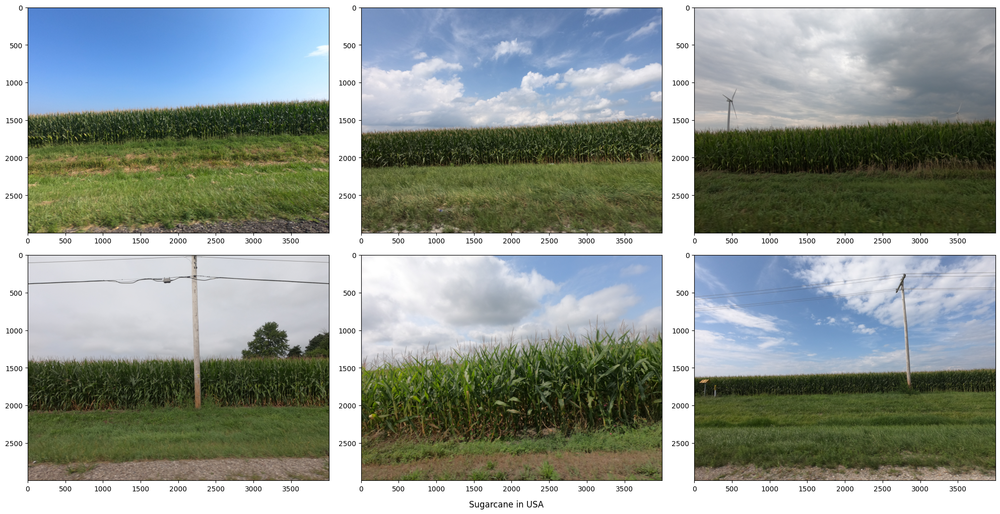

In [68]:
usa_sugarcane_sample = df_crops[(df_crops["country_folder"] == "USA_v2") & (df_crops["sugarcane"] > 0.01)].sample(6)
plot_sample(usa_sugarcane_sample, "Sugarcane in USA")

# Confused with maize

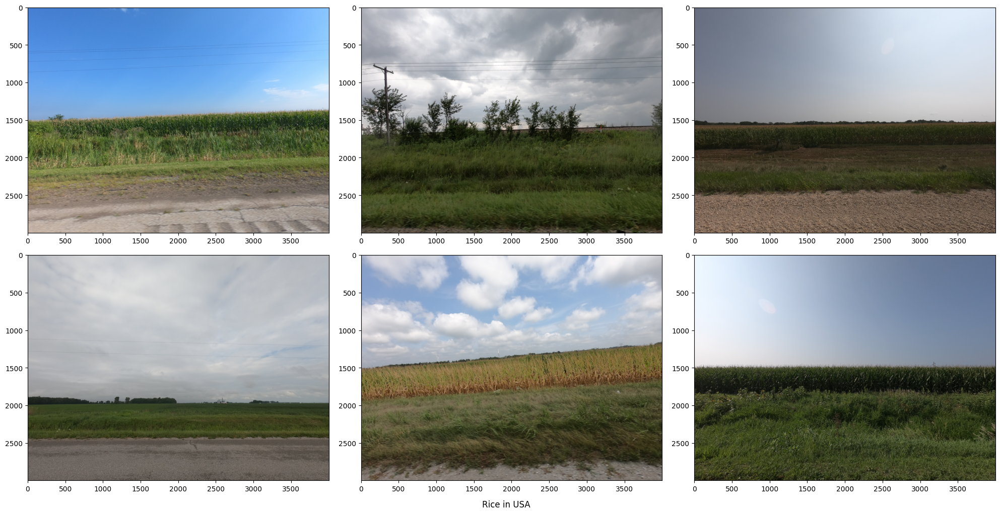

In [69]:
usa_rice_sample = df_crops[(df_crops["country_folder"] == "USA_v2") & (df_crops["rice"] > 0.01)].sample(6)
plot_sample(usa_rice_sample, "Rice in USA")

# Incorrectly classified rice.

### General Takeaways

1. Sunflower is over predicted, many plants with leaves appear to be predicted as sunflower. Follow up: analyze sunflowers in training set, are they distinctly sunflowers or could they be confused?
2. Sugarcane is sometimes correct and often confused with maize.
3. Soybean is mostly predicted in the US and most of it is correct.
4. Rice seems to be predicted when fields are young and crops are short.
5. Tobacco is rarely predicted.
6. Wheat is not predicted often.
7. Maize is predicted fairly well.
8. Banana is predicted fairly well, almost all in Uganda.